In [ ]:
import os
import glob
import time
import numpy as np
from PIL import Image
from pathlib import Path
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
from skimage.color import rgb2lab, lab2rgb

import torch
from torch import nn, optim
from torchvision import transforms
from torchvision.utils import make_grid
from torch.utils.data import Dataset, DataLoader
from model import UnetBlock,Unet,PatchDiscriminator,MainModel
from dataset import ColorizationDataset
from loss import GANLoss
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

In [ ]:
!pip install fastai==2.4

In [ ]:
from fastai.data.external import untar_data, URLs
coco_path = untar_data(URLs.COCO_SAMPLE)
coco_path = str(coco_path) + "/train_sample"

In [ ]:
path = coco_path
paths = glob.glob(path + "/*.jpg") # Grabbing all the image file names
np.random.seed(123)
paths_subset = np.random.choice(paths, 10_000) # choosing 50000 images randomly
rand_idxs = np.random.permutation(10_000)
train_idxs = rand_idxs[:8000] # choosing the first 35000 as training set
val_idxs = rand_idxs[8000:] # choosing last 15000 as validation set
train_paths = paths_subset[train_idxs]
val_paths = paths_subset[val_idxs]
print(len(train_paths), len(val_paths))

8000 2000


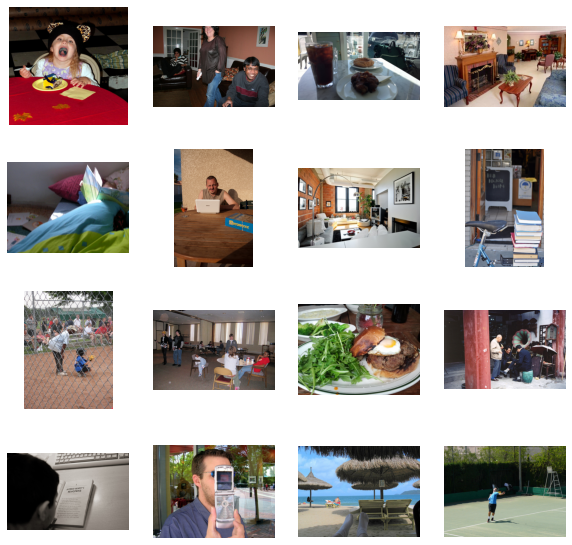

In [ ]:
_, axes = plt.subplots(4, 4, figsize=(10, 10))
for ax, img_path in zip(axes.flatten(), train_paths):
    ax.imshow(Image.open(img_path))
    ax.axis("off")

In [ ]:
SIZE = 256

def make_dataloaders(batch_size=16, n_workers=4, pin_memory=True, **kwargs): # A handy function to make our dataloaders
    dataset = ColorizationDataset(**kwargs)
    dataloader = DataLoader(dataset, batch_size=batch_size, num_workers=n_workers,
                            pin_memory=pin_memory)
    return dataloader

In [ ]:
train_dl = make_dataloaders(paths=train_paths, split='train')
val_dl = make_dataloaders(paths=val_paths, split='val')

data = next(iter(train_dl))
Ls, abs_ = data['L'], data['ab']
print(Ls.shape, abs_.shape)
print(len(train_dl), len(val_dl))

/usr/local/lib/python3.7/dist-packages/torchvision/transforms/transforms.py:281: UserWarning: Argument interpolation should be of type InterpolationMode instead of int. Please, use InterpolationMode enum.
  "Argument interpolation should be of type InterpolationMode instead of int. "
/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


torch.Size([16, 1, 256, 256]) torch.Size([16, 2, 256, 256])
500 125


In [ ]:
def init_weights(net, init='norm', gain=0.02):
    def init_func(m):
        classname = m.__class__.__name__
        if hasattr(m, 'weight') and 'Conv' in classname:
            if init == 'norm':
                nn.init.normal_(m.weight.data, mean=0.0, std=gain)
            elif init == 'xavier':
                nn.init.xavier_normal_(m.weight.data, gain=gain)
            elif init == 'kaiming':
                nn.init.kaiming_normal_(m.weight.data, a=0, mode='fan_in')

            if hasattr(m, 'bias') and m.bias is not None:
                nn.init.constant_(m.bias.data, 0.0)
        elif 'BatchNorm2d' in classname:
            nn.init.normal_(m.weight.data, 1., gain)
            nn.init.constant_(m.bias.data, 0.)

    net.apply(init_func)
    print(f"model initialized with {init} initialization")
    return net


def init_model(model, device):
    model = model.to(device)
    model = init_weights(model)
    return model

In [ ]:
discriminator = PatchDiscriminator(3)
dummy_input = torch.randn(16, 3, 256, 256) # batch_size, channels, size, size
out = discriminator(dummy_input)
out.shape

torch.Size([16, 1, 30, 30])

In [ ]:
class AverageMeter:
    def __init__(self):
        self.reset()
        
    def reset(self):
        self.count, self.avg, self.sum = [0.] * 3
    
    def update(self, val, count=1):
        self.count += count
        self.sum += count * val
        self.avg = self.sum / self.count

def create_loss_meters():
    loss_D_fake = AverageMeter()
    loss_D_real = AverageMeter()
    loss_D = AverageMeter()
    loss_G_GAN = AverageMeter()
    loss_G_L1 = AverageMeter()
    loss_G = AverageMeter()
    
    return {'loss_D_fake': loss_D_fake,
            'loss_D_real': loss_D_real,
            'loss_D': loss_D,
            'loss_G_GAN': loss_G_GAN,
            'loss_G_L1': loss_G_L1,
            'loss_G': loss_G}

def update_losses(model, loss_meter_dict, count):
    for loss_name, loss_meter in loss_meter_dict.items():
        loss = getattr(model, loss_name)
        loss_meter.update(loss.item(), count=count)

def lab_to_rgb(L, ab):
    """
    Takes a batch of images
    """
    
    L = (L + 1.) * 50.
    ab = ab * 110.
    Lab = torch.cat([L, ab], dim=1).permute(0, 2, 3, 1).cpu().numpy()
    rgb_imgs = []
    for img in Lab:
        img_rgb = lab2rgb(img)
        rgb_imgs.append(img_rgb)
    return np.stack(rgb_imgs, axis=0)
    
def visualize(model, data, save=True):
    model.net_G.eval()
    with torch.no_grad():
        model.setup_input(data)
        model.forward()
    model.net_G.train()
    fake_color = model.fake_color.detach()
    real_color = model.ab
    L = model.L
    fake_imgs = lab_to_rgb(L, fake_color)
    real_imgs = lab_to_rgb(L, real_color)
    fig = plt.figure(figsize=(15, 8))
    for i in range(5):
        ax = plt.subplot(3, 5, i + 1)
        ax.imshow(L[i][0].cpu(), cmap='gray')
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 5)
        ax.imshow(fake_imgs[i])
        ax.axis("off")
        ax = plt.subplot(3, 5, i + 1 + 10)
        ax.imshow(real_imgs[i])
        ax.axis("off")
    plt.show()
    if save:
        fig.savefig(f"colorization_{time.time()}.png")
        
def log_results(loss_meter_dict):
    for loss_name, loss_meter in loss_meter_dict.items():
        print(f"{loss_name}: {loss_meter.avg:.5f}")

model initialized with norm initialization
model initialized with norm initialization


/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:481: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 1/35
Iteration 200/500
loss_D_fake: 0.48828
loss_D_real: 0.50854
loss_D: 0.49841
loss_G_GAN: 1.54247
loss_G_L1: 9.55752
loss_G: 11.09999


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 150 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 40 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 5 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 4 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 16 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color 

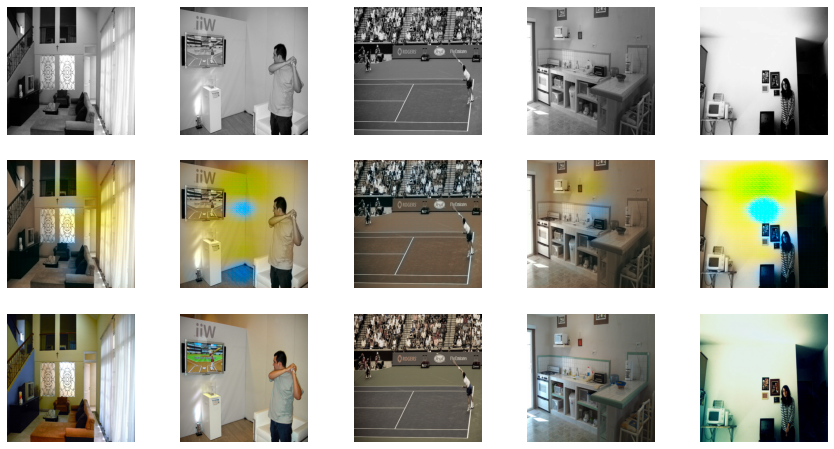


Epoch 1/35
Iteration 400/500
loss_D_fake: 0.48481
loss_D_real: 0.49905
loss_D: 0.49193
loss_G_GAN: 1.53486
loss_G_L1: 10.09092
loss_G: 11.62577


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 14 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 2 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 3 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 1 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


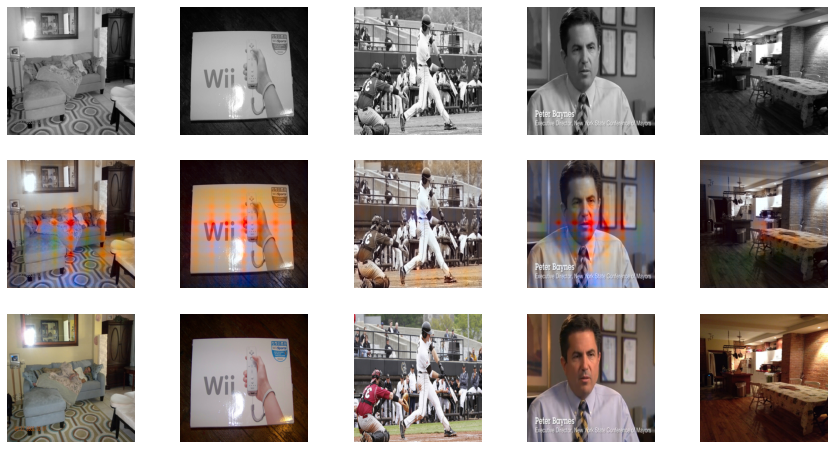

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 2/35
Iteration 200/500
loss_D_fake: 0.53033
loss_D_real: 0.56148
loss_D: 0.54591
loss_G_GAN: 1.33808
loss_G_L1: 10.82662
loss_G: 12.16470


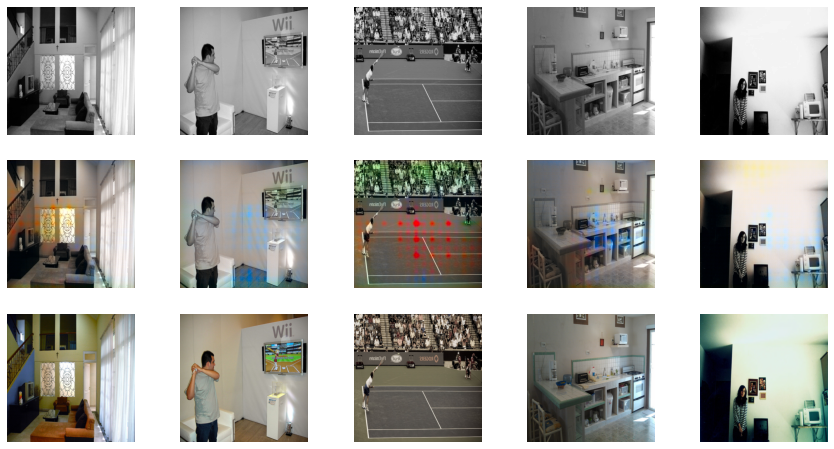


Epoch 2/35
Iteration 400/500
loss_D_fake: 0.52683
loss_D_real: 0.55664
loss_D: 0.54174
loss_G_GAN: 1.32785
loss_G_L1: 10.94156
loss_G: 12.26941


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 6 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 11 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


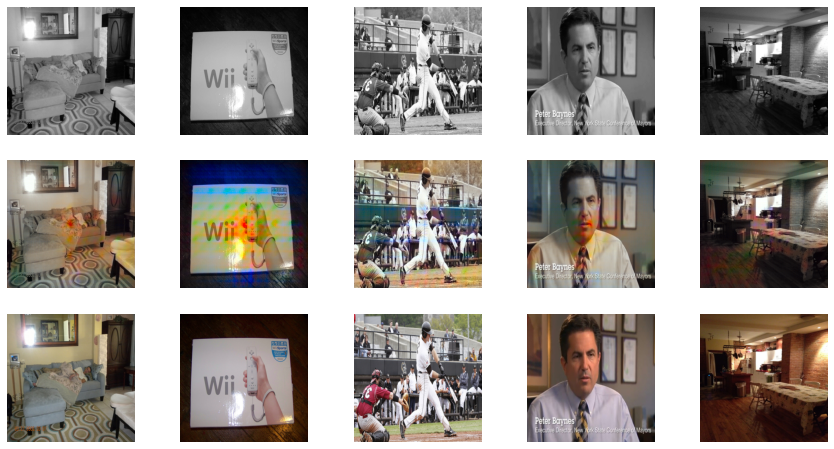

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 3/35
Iteration 200/500
loss_D_fake: 0.53970
loss_D_real: 0.59180
loss_D: 0.56575
loss_G_GAN: 1.26095
loss_G_L1: 10.97801
loss_G: 12.23896


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 41 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 20 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 10 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


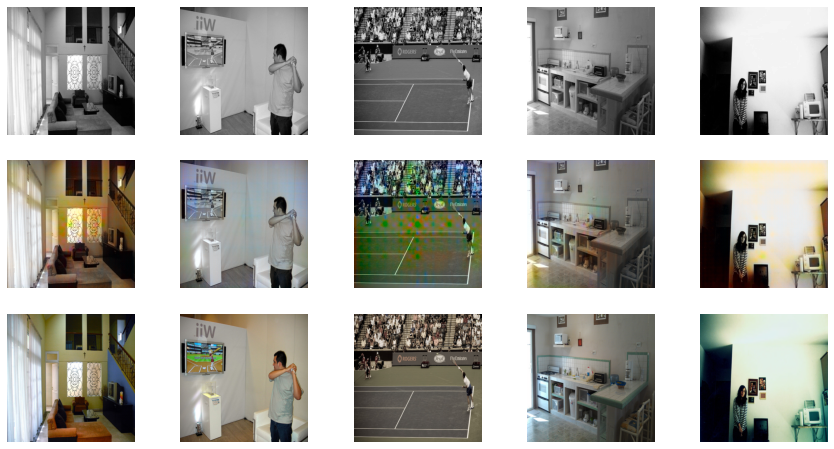


Epoch 3/35
Iteration 400/500
loss_D_fake: 0.53921
loss_D_real: 0.58607
loss_D: 0.56264
loss_G_GAN: 1.24942
loss_G_L1: 11.02111
loss_G: 12.27053


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 12 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


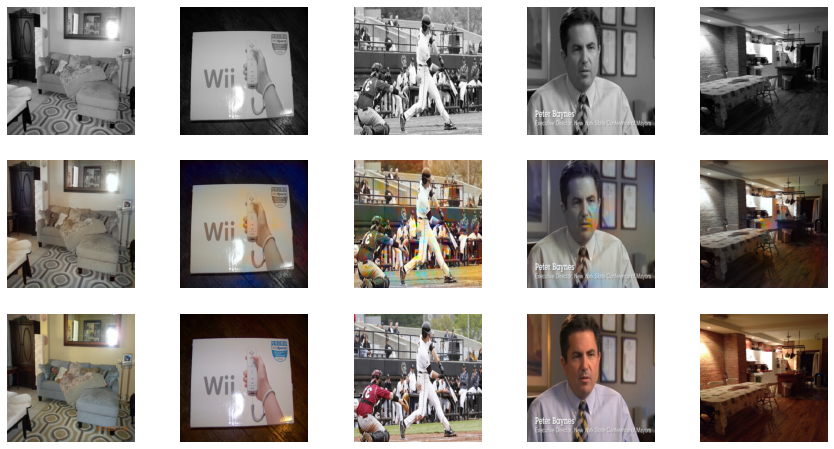

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 4/35
Iteration 200/500
loss_D_fake: 0.54421
loss_D_real: 0.60322
loss_D: 0.57372
loss_G_GAN: 1.19137
loss_G_L1: 10.92684
loss_G: 12.11820


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 203 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 98 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 100 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 71 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 156 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Co

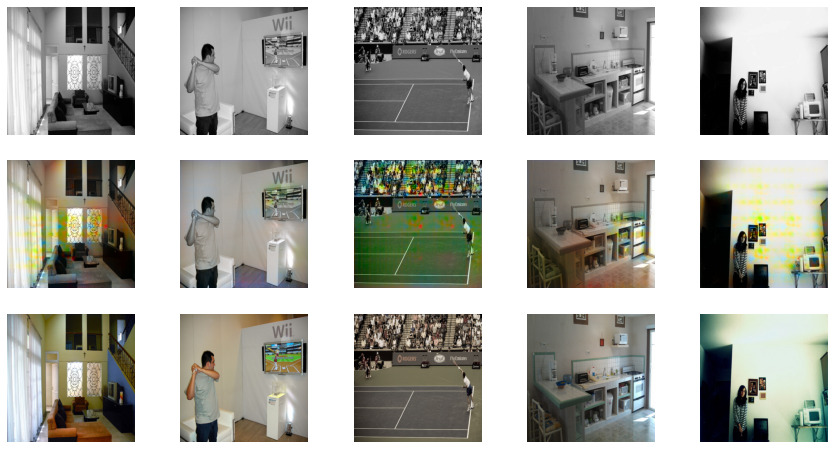


Epoch 4/35
Iteration 400/500
loss_D_fake: 0.53809
loss_D_real: 0.58816
loss_D: 0.56312
loss_G_GAN: 1.20555
loss_G_L1: 10.96559
loss_G: 12.17114


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 15 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


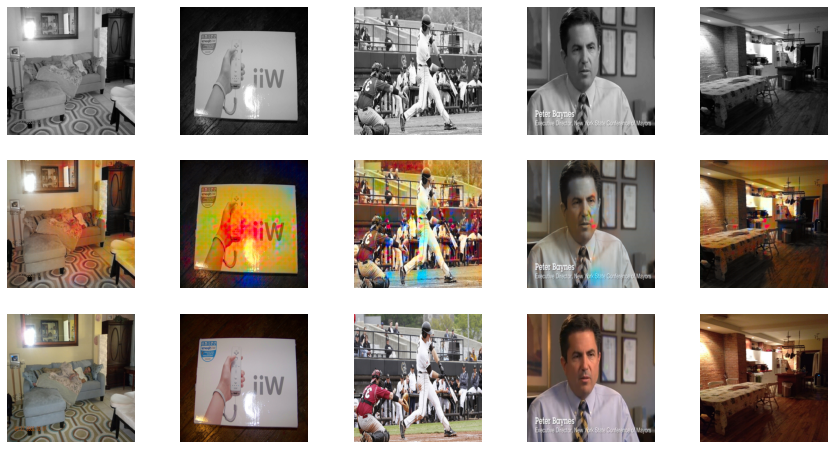

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 5/35
Iteration 200/500
loss_D_fake: 0.53534
loss_D_real: 0.59743
loss_D: 0.56639
loss_G_GAN: 1.20581
loss_G_L1: 10.80638
loss_G: 12.01218


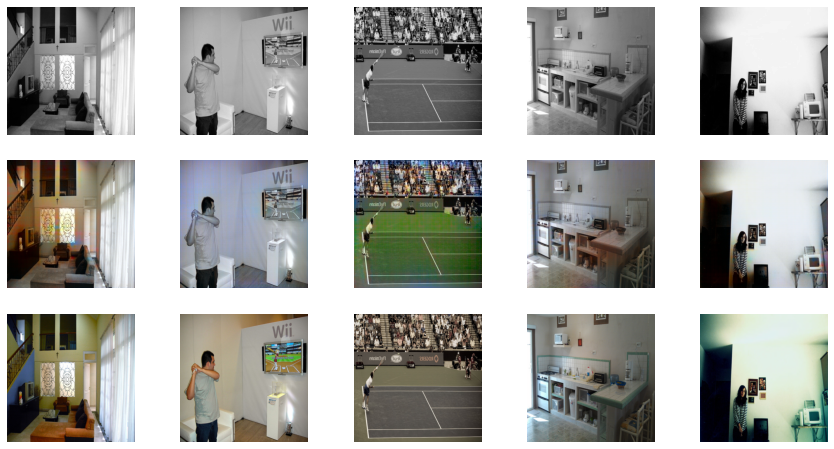


Epoch 5/35
Iteration 400/500
loss_D_fake: 0.53627
loss_D_real: 0.58945
loss_D: 0.56286
loss_G_GAN: 1.21984
loss_G_L1: 10.86975
loss_G: 12.08959


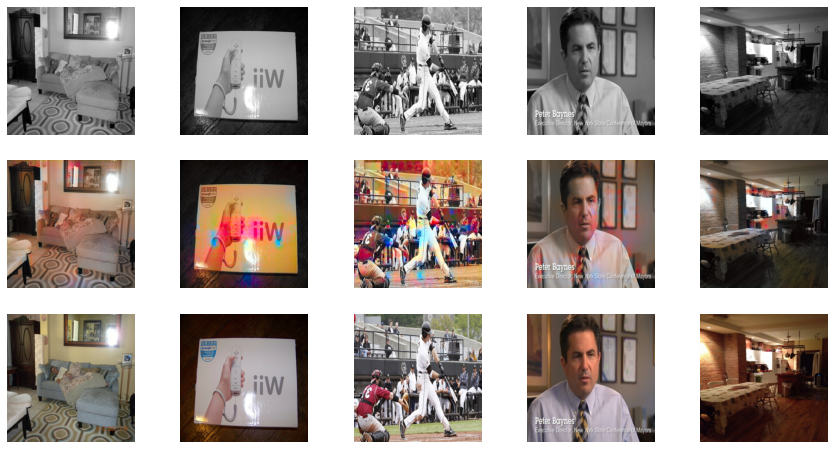

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 6/35
Iteration 200/500
loss_D_fake: 0.54519
loss_D_real: 0.60537
loss_D: 0.57528
loss_G_GAN: 1.17637
loss_G_L1: 10.74856
loss_G: 11.92493


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 9 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


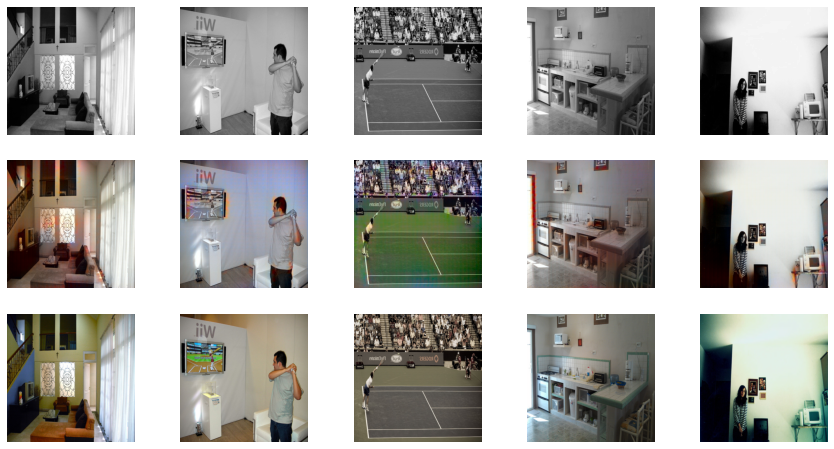


Epoch 6/35
Iteration 400/500
loss_D_fake: 0.54283
loss_D_real: 0.59758
loss_D: 0.57021
loss_G_GAN: 1.19119
loss_G_L1: 10.81174
loss_G: 12.00294


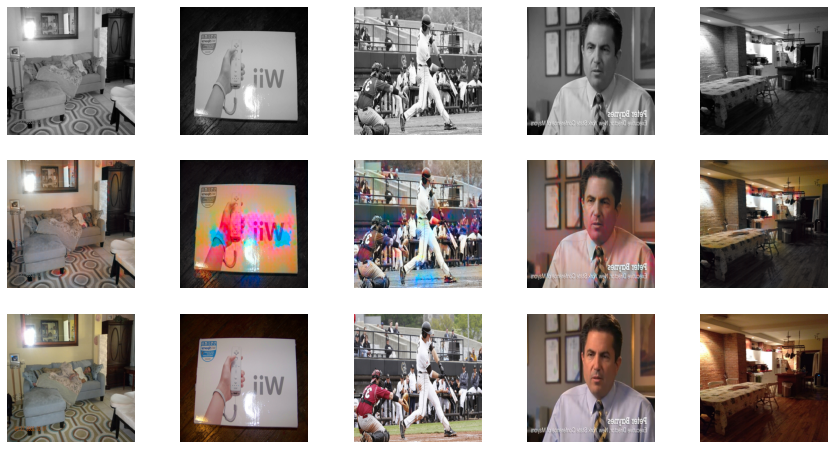

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 7/35
Iteration 200/500
loss_D_fake: 0.54517
loss_D_real: 0.59692
loss_D: 0.57105
loss_G_GAN: 1.18839
loss_G_L1: 10.61981
loss_G: 11.80819


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 8 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 18 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 24 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 13 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


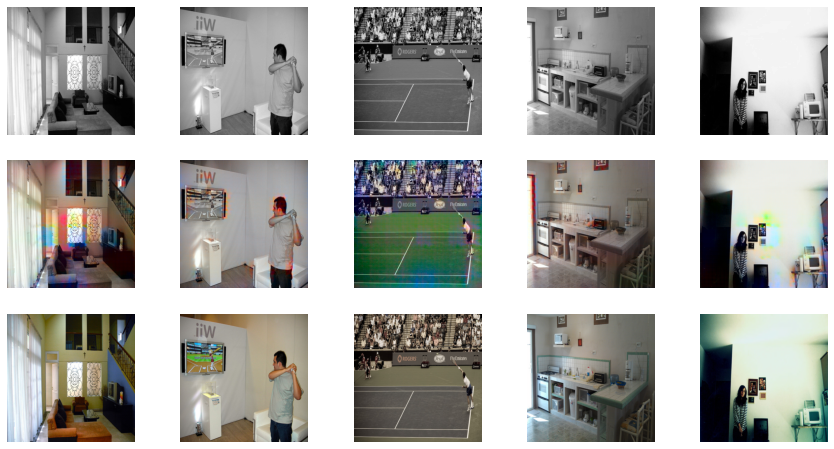


Epoch 7/35
Iteration 400/500
loss_D_fake: 0.54057
loss_D_real: 0.59328
loss_D: 0.56692
loss_G_GAN: 1.20372
loss_G_L1: 10.67532
loss_G: 11.87904


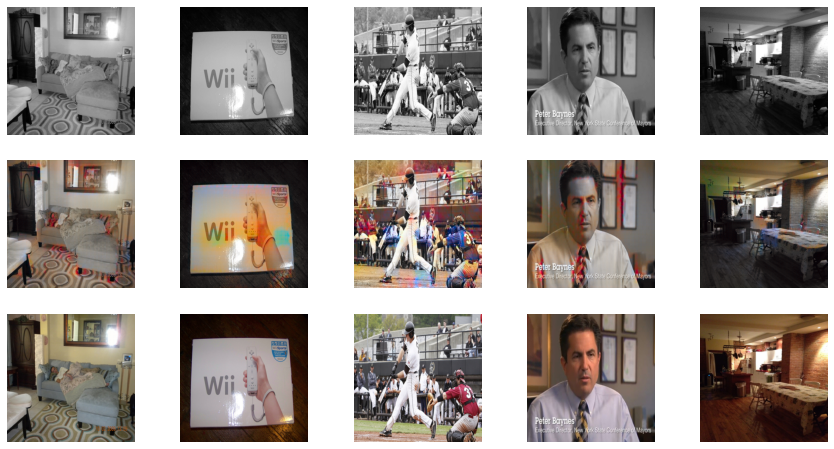

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 8/35
Iteration 200/500
loss_D_fake: 0.54692
loss_D_real: 0.59877
loss_D: 0.57285
loss_G_GAN: 1.17880
loss_G_L1: 10.49246
loss_G: 11.67126


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 102 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 19 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 51 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


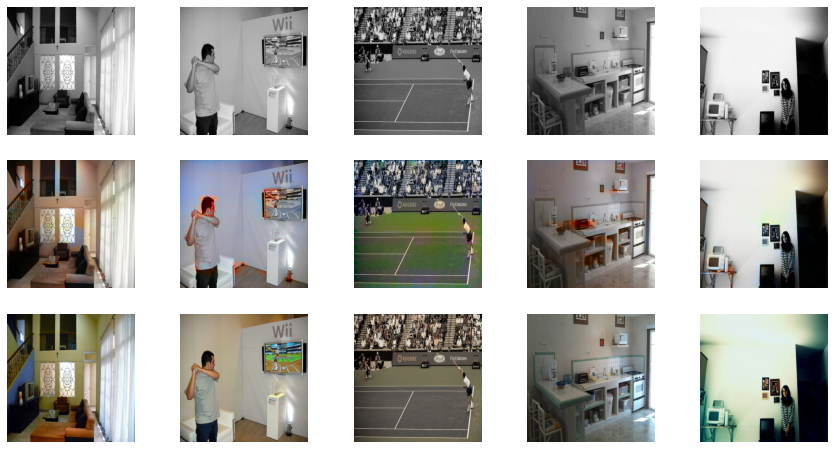


Epoch 8/35
Iteration 400/500
loss_D_fake: 0.53685
loss_D_real: 0.58804
loss_D: 0.56244
loss_G_GAN: 1.19357
loss_G_L1: 10.52552
loss_G: 11.71909


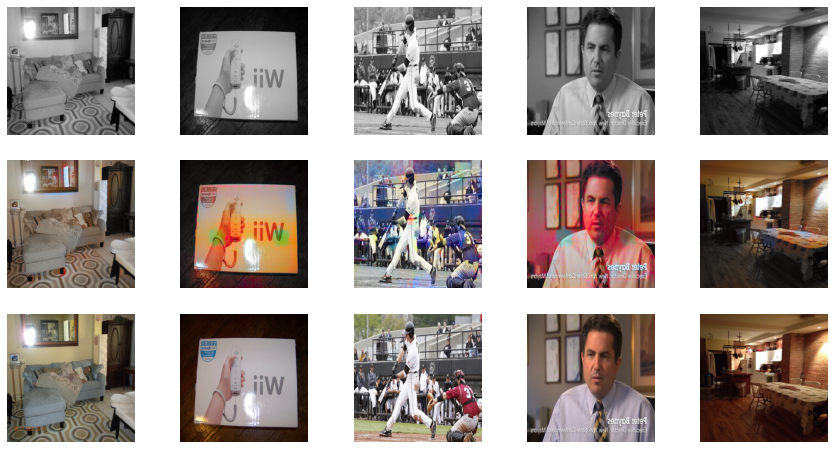

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 9/35
Iteration 200/500
loss_D_fake: 0.53954
loss_D_real: 0.59178
loss_D: 0.56566
loss_G_GAN: 1.17936
loss_G_L1: 10.35200
loss_G: 11.53136


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 434 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 37 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 241 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


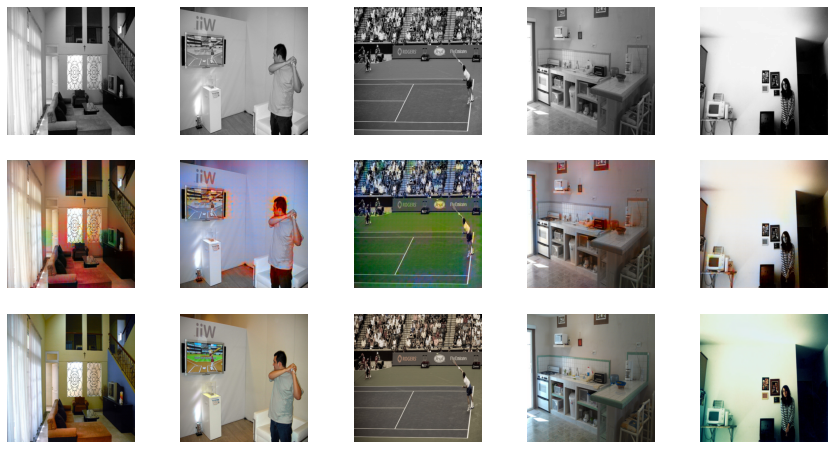


Epoch 9/35
Iteration 400/500
loss_D_fake: 0.53714
loss_D_real: 0.58820
loss_D: 0.56267
loss_G_GAN: 1.19603
loss_G_L1: 10.37712
loss_G: 11.57316


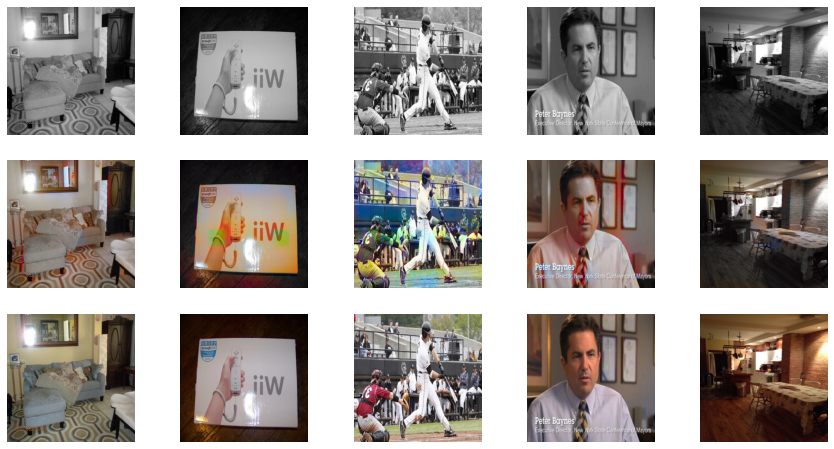

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 10/35
Iteration 200/500
loss_D_fake: 0.53272
loss_D_real: 0.58588
loss_D: 0.55930
loss_G_GAN: 1.21051
loss_G_L1: 10.22026
loss_G: 11.43077


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 353 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 80 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 47 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


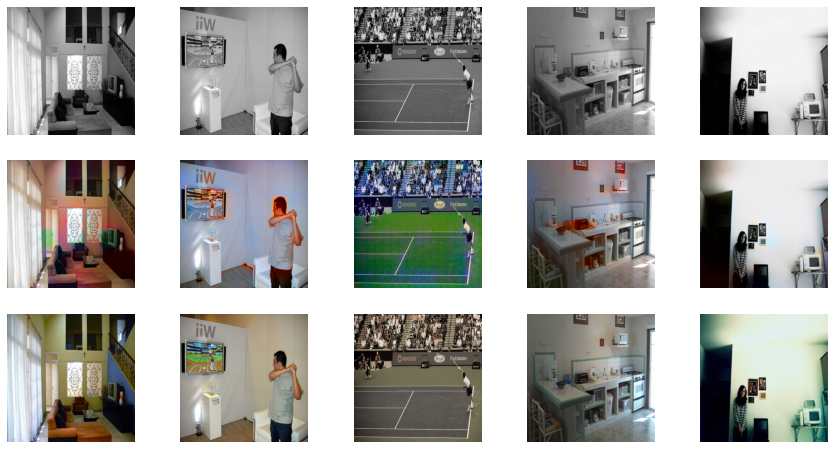


Epoch 10/35
Iteration 400/500
loss_D_fake: 0.52799
loss_D_real: 0.57902
loss_D: 0.55350
loss_G_GAN: 1.21818
loss_G_L1: 10.22609
loss_G: 11.44427


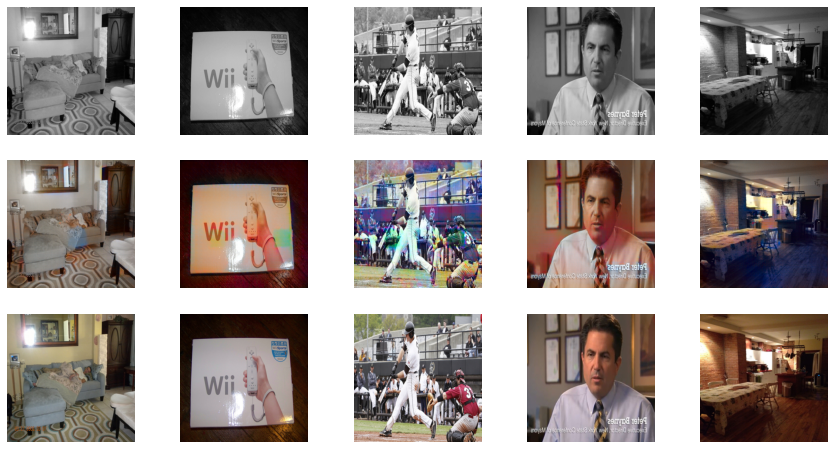

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 11/35
Iteration 200/500
loss_D_fake: 0.53085
loss_D_real: 0.58269
loss_D: 0.55677
loss_G_GAN: 1.20227
loss_G_L1: 10.10000
loss_G: 11.30227


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 343 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 74 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 87 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


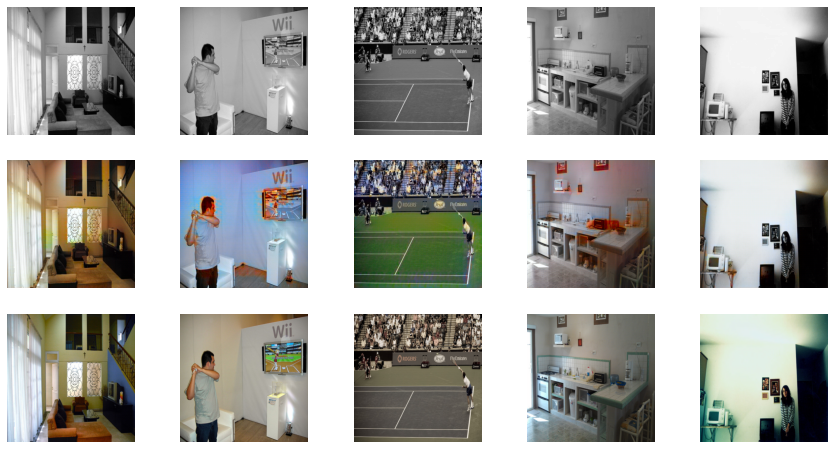


Epoch 11/35
Iteration 400/500
loss_D_fake: 0.52681
loss_D_real: 0.57612
loss_D: 0.55146
loss_G_GAN: 1.22047
loss_G_L1: 10.09699
loss_G: 11.31747


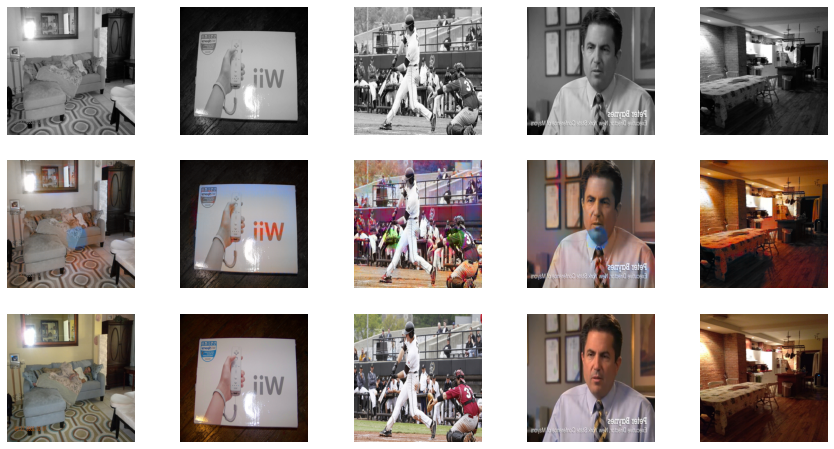

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 12/35
Iteration 200/500
loss_D_fake: 0.52587
loss_D_real: 0.57056
loss_D: 0.54822
loss_G_GAN: 1.21695
loss_G_L1: 9.91973
loss_G: 11.13667


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 175 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


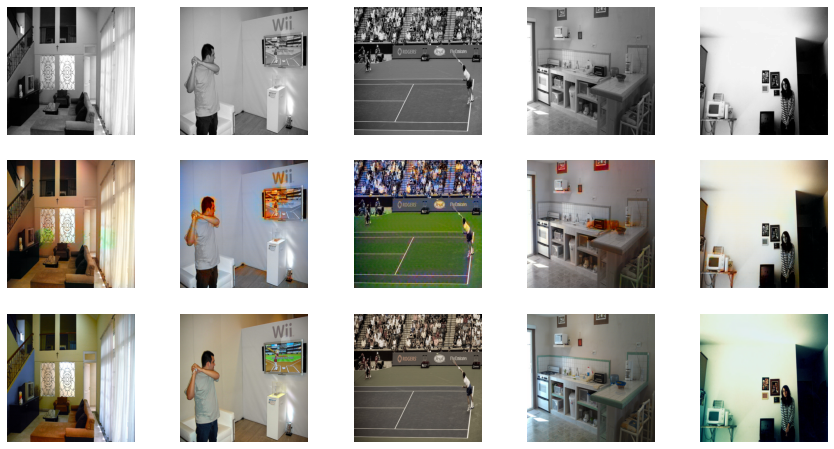


Epoch 12/35
Iteration 400/500
loss_D_fake: 0.52379
loss_D_real: 0.56725
loss_D: 0.54552
loss_G_GAN: 1.23401
loss_G_L1: 9.91971
loss_G: 11.15372


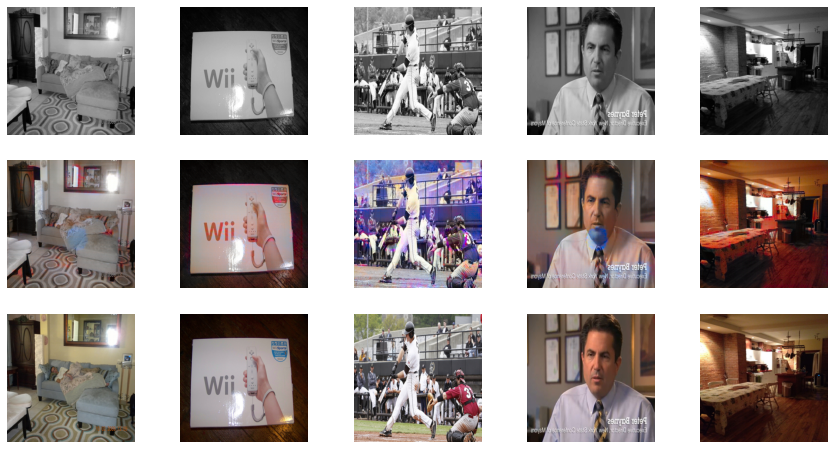

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 13/35
Iteration 200/500
loss_D_fake: 0.52759
loss_D_real: 0.57168
loss_D: 0.54963
loss_G_GAN: 1.23852
loss_G_L1: 9.79255
loss_G: 11.03107


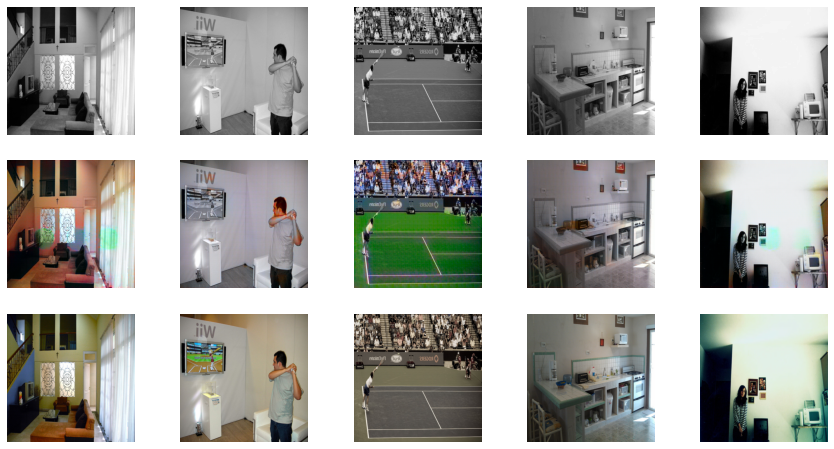


Epoch 13/35
Iteration 400/500
loss_D_fake: 0.52352
loss_D_real: 0.56649
loss_D: 0.54500
loss_G_GAN: 1.25786
loss_G_L1: 9.79277
loss_G: 11.05063


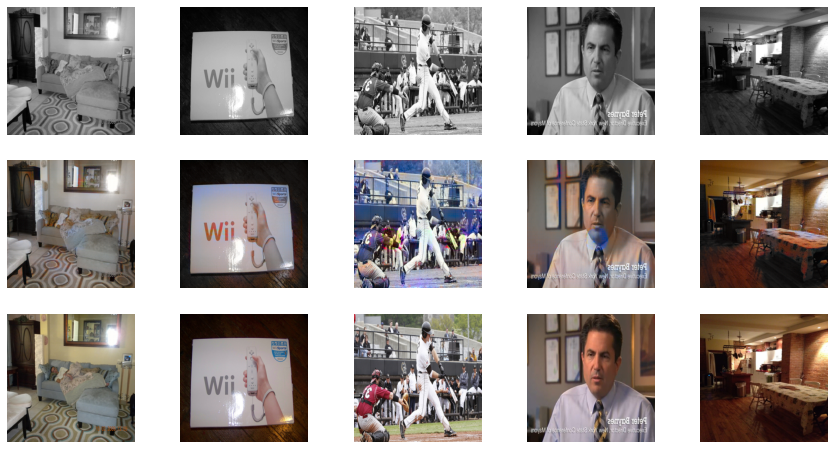

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 14/35
Iteration 200/500
loss_D_fake: 0.52563
loss_D_real: 0.56465
loss_D: 0.54514
loss_G_GAN: 1.24793
loss_G_L1: 9.61517
loss_G: 10.86309


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 205 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 72 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))
/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 117 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


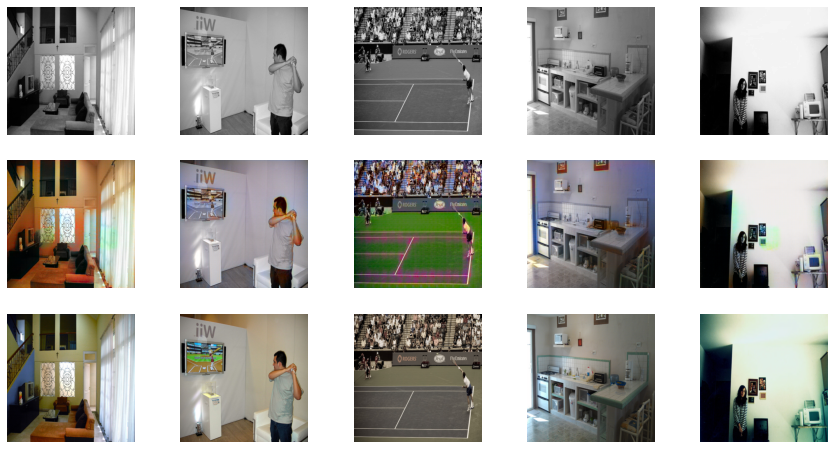


Epoch 14/35
Iteration 400/500
loss_D_fake: 0.52241
loss_D_real: 0.56103
loss_D: 0.54172
loss_G_GAN: 1.26458
loss_G_L1: 9.62121
loss_G: 10.88578


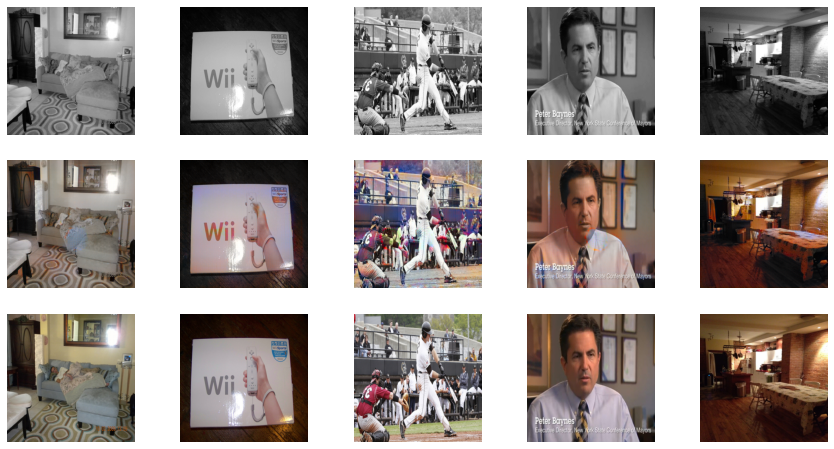

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 15/35
Iteration 200/500
loss_D_fake: 0.51844
loss_D_real: 0.55728
loss_D: 0.53786
loss_G_GAN: 1.24373
loss_G_L1: 9.46585
loss_G: 10.70958


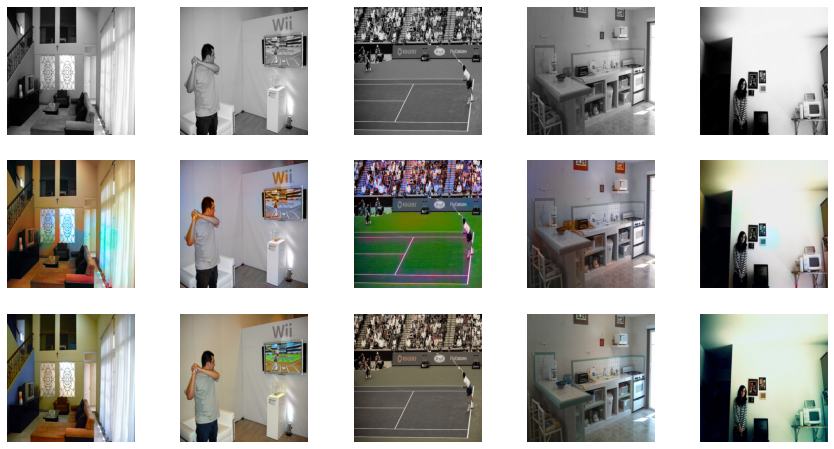


Epoch 15/35
Iteration 400/500
loss_D_fake: 0.51862
loss_D_real: 0.55869
loss_D: 0.53865
loss_G_GAN: 1.26170
loss_G_L1: 9.46759
loss_G: 10.72929


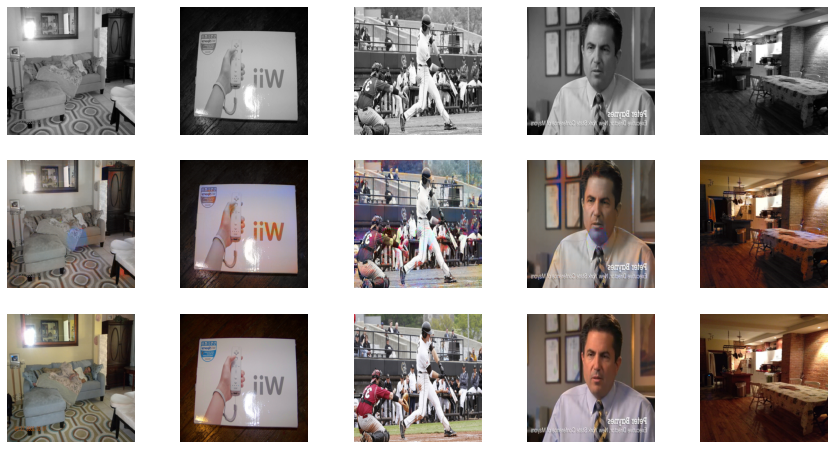

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 16/35
Iteration 200/500
loss_D_fake: 0.52605
loss_D_real: 0.56371
loss_D: 0.54488
loss_G_GAN: 1.23772
loss_G_L1: 9.31419
loss_G: 10.55191


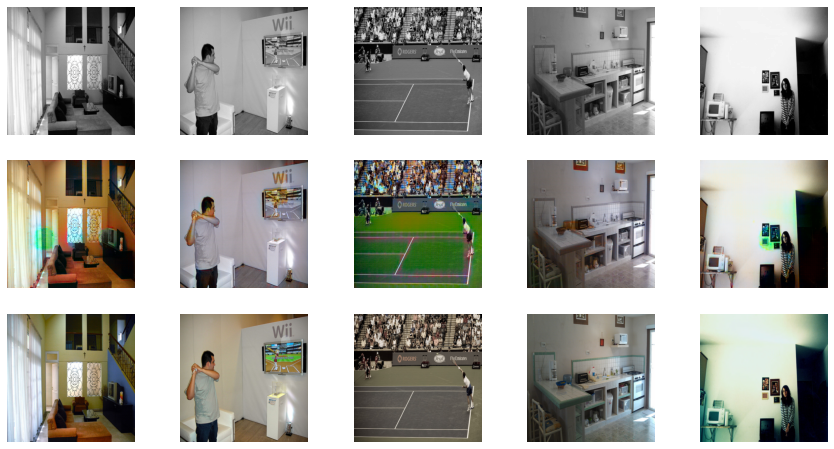


Epoch 16/35
Iteration 400/500
loss_D_fake: 0.52763
loss_D_real: 0.56570
loss_D: 0.54667
loss_G_GAN: 1.25668
loss_G_L1: 9.31151
loss_G: 10.56819


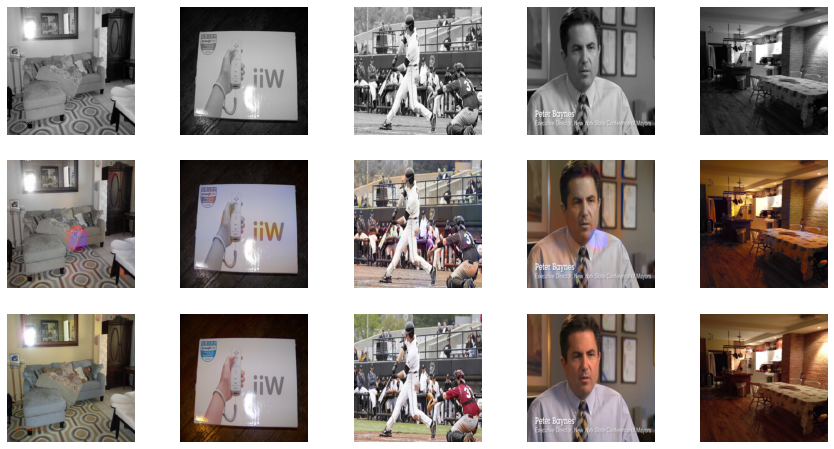

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 17/35
Iteration 200/500
loss_D_fake: 0.53399
loss_D_real: 0.56901
loss_D: 0.55150
loss_G_GAN: 1.24188
loss_G_L1: 9.15798
loss_G: 10.39985


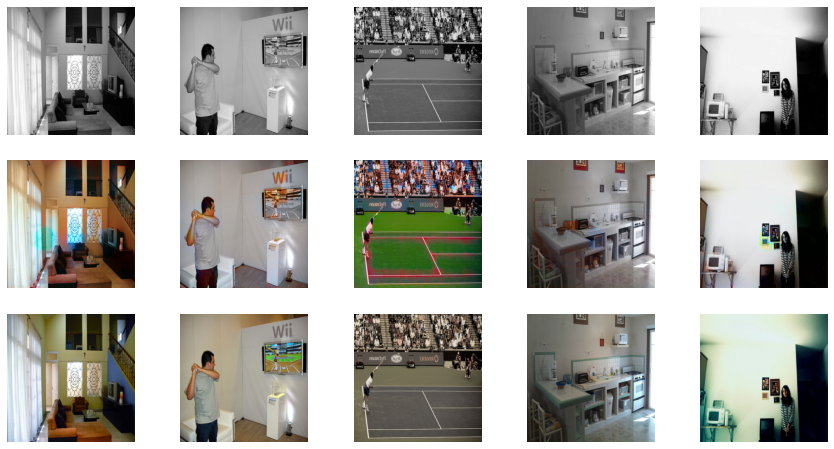


Epoch 17/35
Iteration 400/500
loss_D_fake: 0.53124
loss_D_real: 0.56977
loss_D: 0.55051
loss_G_GAN: 1.25065
loss_G_L1: 9.16913
loss_G: 10.41978


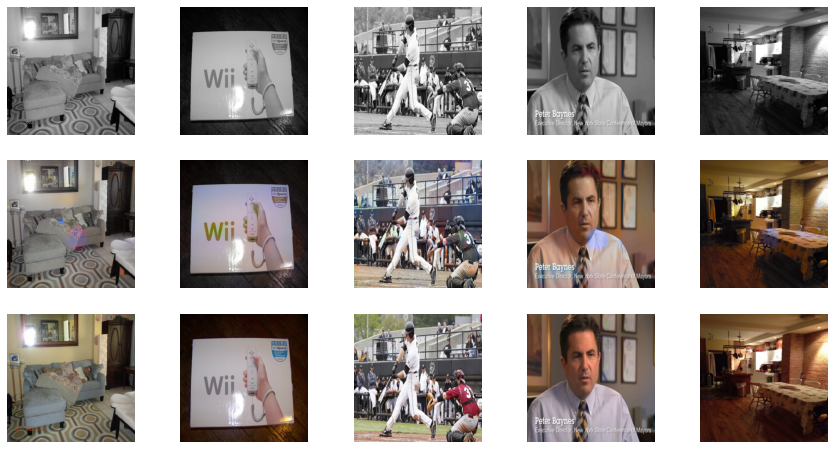

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 18/35
Iteration 200/500
loss_D_fake: 0.53501
loss_D_real: 0.57122
loss_D: 0.55311
loss_G_GAN: 1.22467
loss_G_L1: 9.03776
loss_G: 10.26243


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 7 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


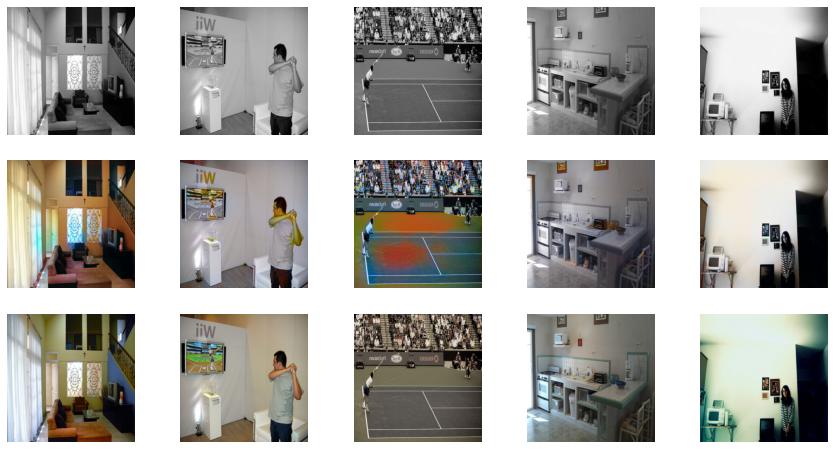


Epoch 18/35
Iteration 400/500
loss_D_fake: 0.52988
loss_D_real: 0.56826
loss_D: 0.54907
loss_G_GAN: 1.24322
loss_G_L1: 9.05118
loss_G: 10.29440


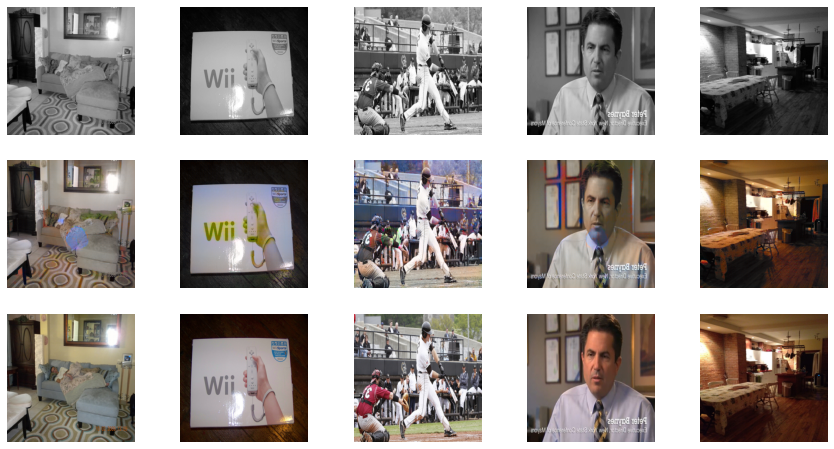

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 19/35
Iteration 200/500
loss_D_fake: 0.53254
loss_D_real: 0.56450
loss_D: 0.54852
loss_G_GAN: 1.24777
loss_G_L1: 8.86118
loss_G: 10.10895


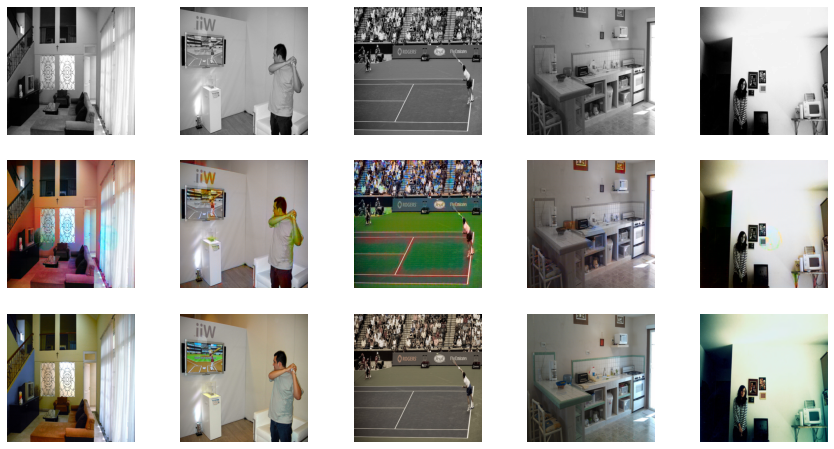


Epoch 19/35
Iteration 400/500
loss_D_fake: 0.52952
loss_D_real: 0.56572
loss_D: 0.54762
loss_G_GAN: 1.25739
loss_G_L1: 8.87103
loss_G: 10.12842


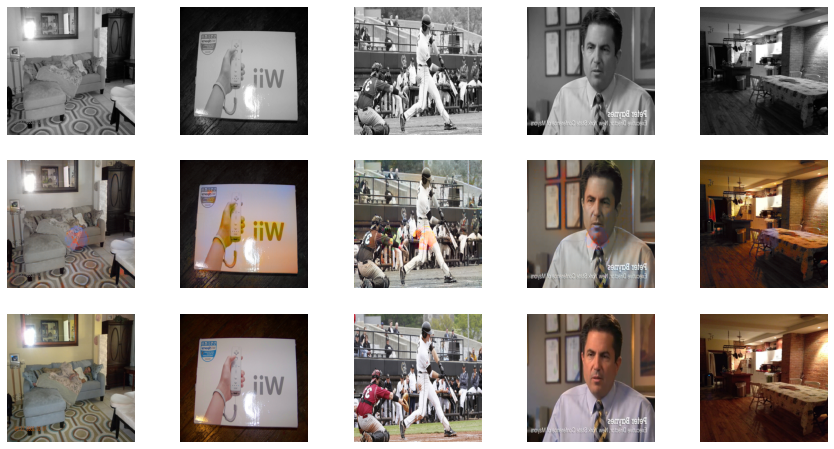

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 20/35
Iteration 200/500
loss_D_fake: 0.52722
loss_D_real: 0.55952
loss_D: 0.54337
loss_G_GAN: 1.23781
loss_G_L1: 8.71742
loss_G: 9.95522


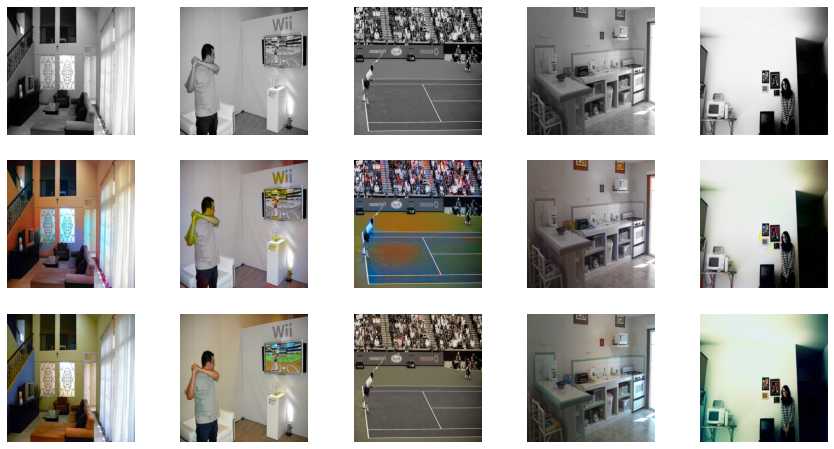


Epoch 20/35
Iteration 400/500
loss_D_fake: 0.52902
loss_D_real: 0.56095
loss_D: 0.54498
loss_G_GAN: 1.25448
loss_G_L1: 8.74745
loss_G: 10.00193


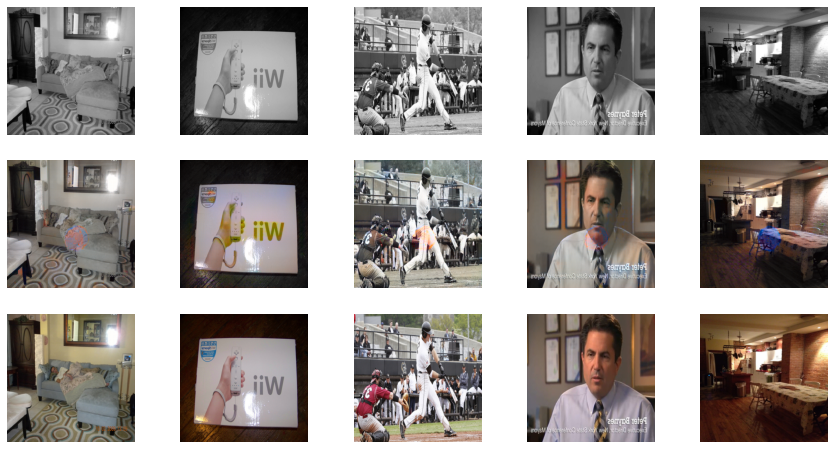

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 21/35
Iteration 200/500
loss_D_fake: 0.53045
loss_D_real: 0.56194
loss_D: 0.54619
loss_G_GAN: 1.25020
loss_G_L1: 8.60702
loss_G: 9.85722


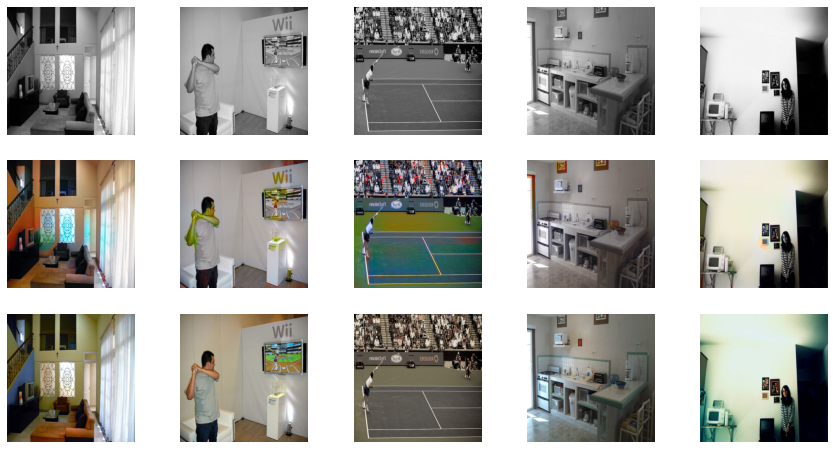


Epoch 21/35
Iteration 400/500
loss_D_fake: 0.53084
loss_D_real: 0.56467
loss_D: 0.54775
loss_G_GAN: 1.26563
loss_G_L1: 8.61523
loss_G: 9.88086


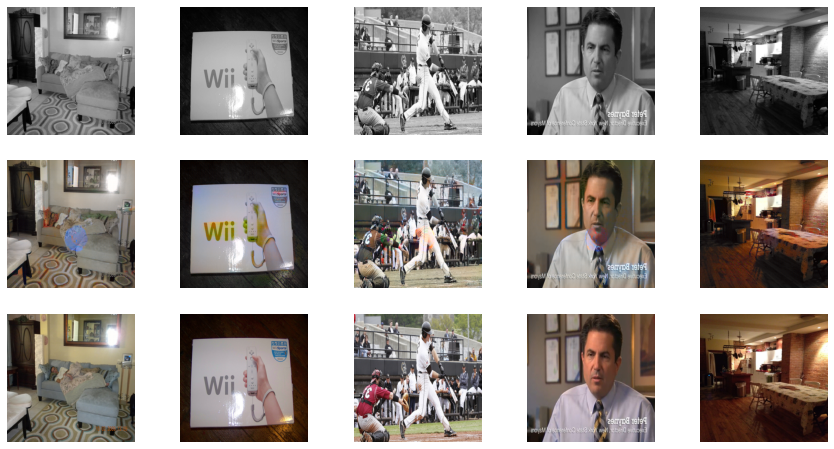

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 22/35
Iteration 200/500
loss_D_fake: 0.52522
loss_D_real: 0.55533
loss_D: 0.54028
loss_G_GAN: 1.24027
loss_G_L1: 8.49899
loss_G: 9.73927


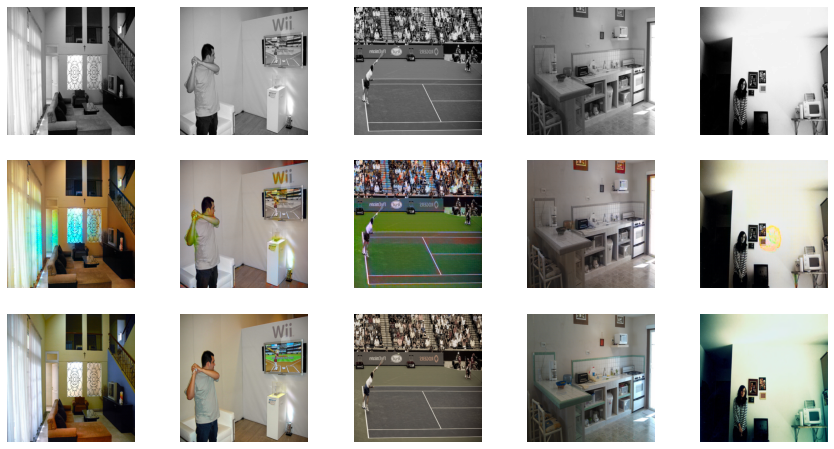


Epoch 22/35
Iteration 400/500
loss_D_fake: 0.52587
loss_D_real: 0.55774
loss_D: 0.54180
loss_G_GAN: 1.26494
loss_G_L1: 8.49232
loss_G: 9.75725


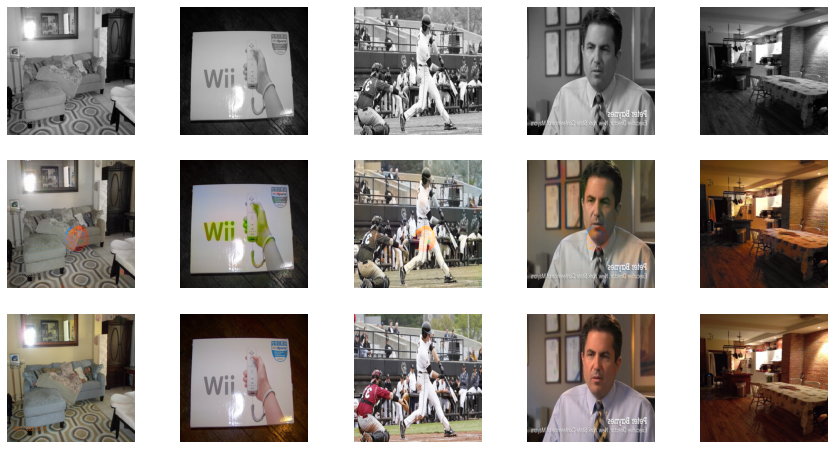

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 23/35
Iteration 200/500
loss_D_fake: 0.52784
loss_D_real: 0.55847
loss_D: 0.54315
loss_G_GAN: 1.26512
loss_G_L1: 8.34660
loss_G: 9.61172


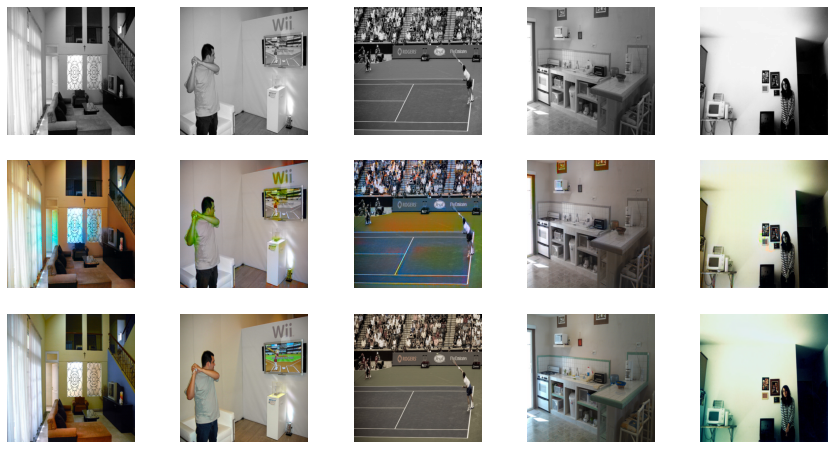


Epoch 23/35
Iteration 400/500
loss_D_fake: 0.52673
loss_D_real: 0.55847
loss_D: 0.54260
loss_G_GAN: 1.27707
loss_G_L1: 8.36505
loss_G: 9.64211


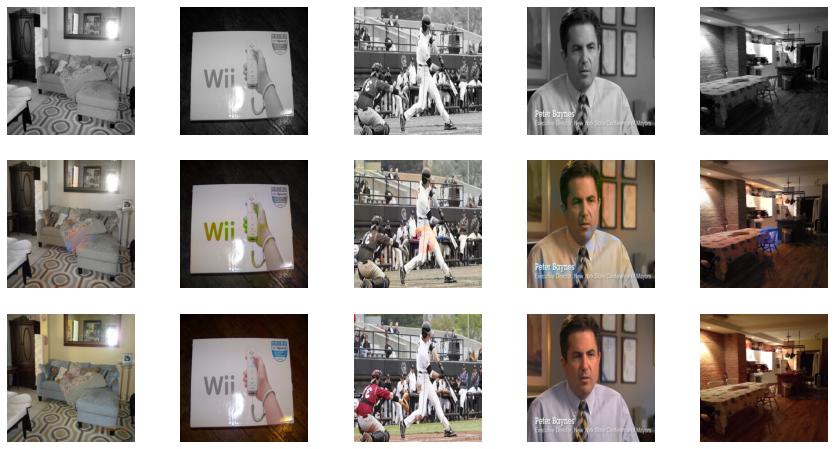

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 24/35
Iteration 200/500
loss_D_fake: 0.52200
loss_D_real: 0.54591
loss_D: 0.53395
loss_G_GAN: 1.27586
loss_G_L1: 8.25017
loss_G: 9.52604


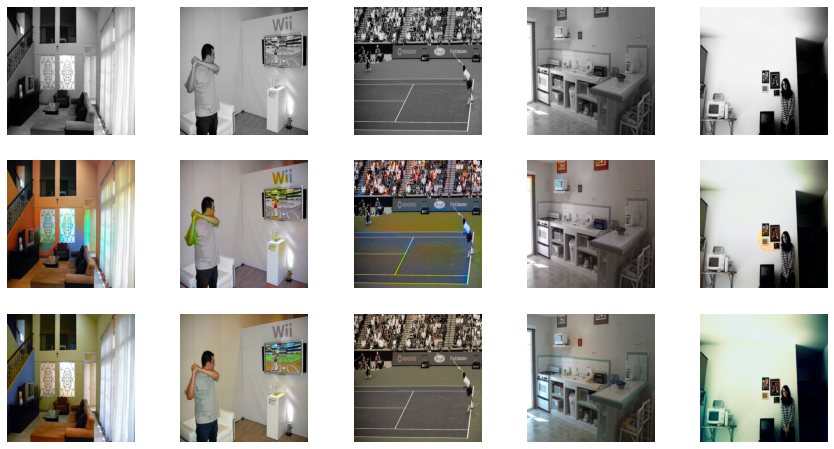


Epoch 24/35
Iteration 400/500
loss_D_fake: 0.52402
loss_D_real: 0.54995
loss_D: 0.53698
loss_G_GAN: 1.29228
loss_G_L1: 8.25779
loss_G: 9.55007


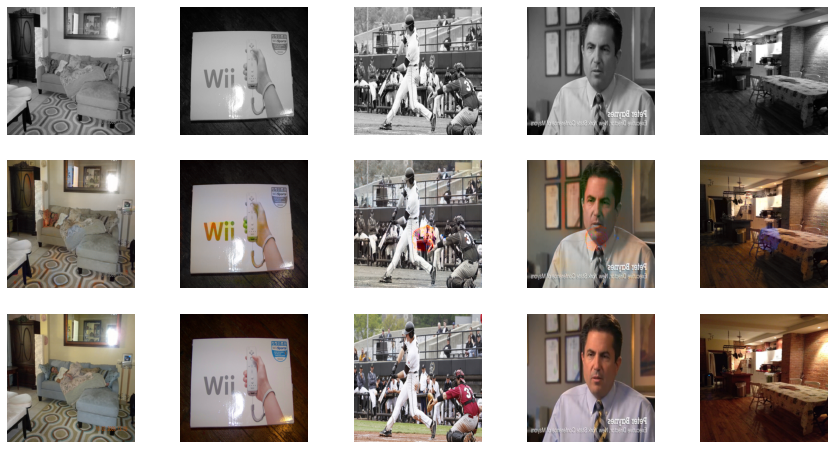

  0%|          | 0/500 [00:00<?, ?it/s]


Epoch 25/35
Iteration 200/500
loss_D_fake: 0.52498
loss_D_real: 0.54981
loss_D: 0.53739
loss_G_GAN: 1.29499
loss_G_L1: 8.12565
loss_G: 9.42064


/usr/local/lib/python3.7/dist-packages/skimage/color/colorconv.py:1109: UserWarning: Color data out of range: Z < 0 in 21 pixels
  return xyz2rgb(lab2xyz(lab, illuminant, observer))


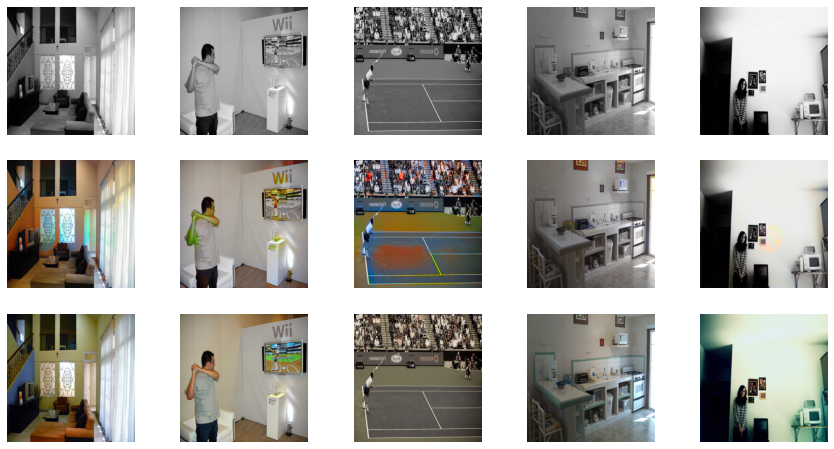

In [ ]:
def train_model(model, train_dl, epochs, display_every=200):
    data = next(iter(val_dl)) # getting a batch for visualizing the model output after fixed intrvals
    for e in range(epochs):
        loss_meter_dict = create_loss_meters() # function returing a dictionary of objects to 
        i = 0                                  # log the losses of the complete network
        for data in tqdm(train_dl):
            model.setup_input(data) 
            model.optimize()
            update_losses(model, loss_meter_dict, count=data['L'].size(0)) # function updating the log objects
            i += 1
            if i % display_every == 0:
                print(f"\nEpoch {e+1}/{epochs}")
                print(f"Iteration {i}/{len(train_dl)}")
                log_results(loss_meter_dict) # function to print out the losses
                visualize(model, data, save=False) # function displaying the model's outputs

model = MainModel()
train_model(model, train_dl, 35)